<a href="https://colab.research.google.com/github/Anuj-gitch/DataScience/blob/main/End_to_End_Brest_Cancer_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Brest Cancer Detection

**Goal of the project**

    In all around the world more then 15% womens are suffer with breast cancer. 

    So here by using ML we will build the model which will going to predict wheather a patient have a brest cancer or not.

    To complete this task we are using supervised machine learning algorithms.

    Here we are going to try one model and evaluate it. After all this we will deploy the best fitted model.


**What is Successs**

    We will try to get atleast 95% accuaracy, precsion and recall.

**Data**

    target column is are target variable. Were we have 0 and 1. 0 represent not-diseased and 1 represent diseased.

## Import Essential Libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Data Loading

In [ ]:
from sklearn.datasets import load_breast_cancer

cancer_dataset = load_breast_cancer()
cancer_dataset

{'DESCR': '.. _breast_cancer_dataset:\n\nBreast cancer wisconsin (diagnostic) dataset\n--------------------------------------------\n\n**Data Set Characteristics:**\n\n    :Number of Instances: 569\n\n    :Number of Attributes: 30 numeric, predictive attributes and the class\n\n    :Attribute Information:\n        - radius (mean of distances from center to points on the perimeter)\n        - texture (standard deviation of gray-scale values)\n        - perimeter\n        - area\n        - smoothness (local variation in radius lengths)\n        - compactness (perimeter^2 / area - 1.0)\n        - concavity (severity of concave portions of the contour)\n        - concave points (number of concave portions of the contour)\n        - symmetry \n        - fractal dimension ("coastline approximation" - 1)\n\n        The mean, standard error, and "worst" or largest (mean of the three\n        largest values) of these features were computed for each image,\n        resulting in 30 features.  For

## Data Manupulation

In [ ]:
type(cancer_dataset)

sklearn.utils.Bunch

In [ ]:
# keys of the dataset
cancer_dataset.keys()

dict_keys(['data', 'target', 'target_names', 'DESCR', 'feature_names', 'filename'])

In [ ]:
# feature cells are in numeric format
cancer_dataset['data']

array([[1.799e+01, 1.038e+01, 1.228e+02, ..., 2.654e-01, 4.601e-01,
        1.189e-01],
       [2.057e+01, 1.777e+01, 1.329e+02, ..., 1.860e-01, 2.750e-01,
        8.902e-02],
       [1.969e+01, 2.125e+01, 1.300e+02, ..., 2.430e-01, 3.613e-01,
        8.758e-02],
       ...,
       [1.660e+01, 2.808e+01, 1.083e+02, ..., 1.418e-01, 2.218e-01,
        7.820e-02],
       [2.060e+01, 2.933e+01, 1.401e+02, ..., 2.650e-01, 4.087e-01,
        1.240e-01],
       [7.760e+00, 2.454e+01, 4.792e+01, ..., 0.000e+00, 2.871e-01,
        7.039e-02]])

In [ ]:
type(cancer_dataset['data'])

numpy.ndarray

In [ ]:
# target value
cancer_dataset['target']

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1,
       1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0,
       0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0,

**Here 0 represent `not diseased` and 1 represent `diseased`**

In [ ]:
#Description of the data
print(cancer_dataset['DESCR'])

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on the perimeter)
        - texture (standard deviation of gray-scale values)
        - perimeter
        - area
        - smoothness (local variation in radius lengths)
        - compactness (perimeter^2 / area - 1.0)
        - concavity (severity of concave portions of the contour)
        - concave points (number of concave portions of the contour)
        - symmetry 
        - fractal dimension ("coastline approximation" - 1)

        The mean, standard error, and "worst" or largest (mean of the three
        largest values) of these features were computed for each image,
        resulting in 30 features.  For instance, field 3 is Mean Radius, f

In [ ]:
print(cancer_dataset['feature_names'])

['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


In [ ]:
print(cancer_dataset['filename']) # this is a file path

/usr/local/lib/python3.6/dist-packages/sklearn/datasets/data/breast_cancer.csv


## Create a Dataframe from dictionary

In [ ]:
cancer_df = pd.DataFrame(cancer_dataset['data'] ,columns=cancer_dataset.feature_names)
cancer_df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
# Export dataset as csv
import os

if 'cancer_df.csv' in os.listdir('/content/drive/My Drive/MachineLearning_Projects/Brest_Cancer_detection'):
  pass
else:
  cancer_df.to_csv('/content/drive/My Drive/MachineLearning_Projects/Brest_Cancer_detection/cancer_df.csv')

In [ ]:
cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [ ]:
cancer_df.isna().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
dtype: int64

In [ ]:
cancer_df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [ ]:
cancer_df['target'] = cancer_dataset['target']

## Exploratory Data Analysis

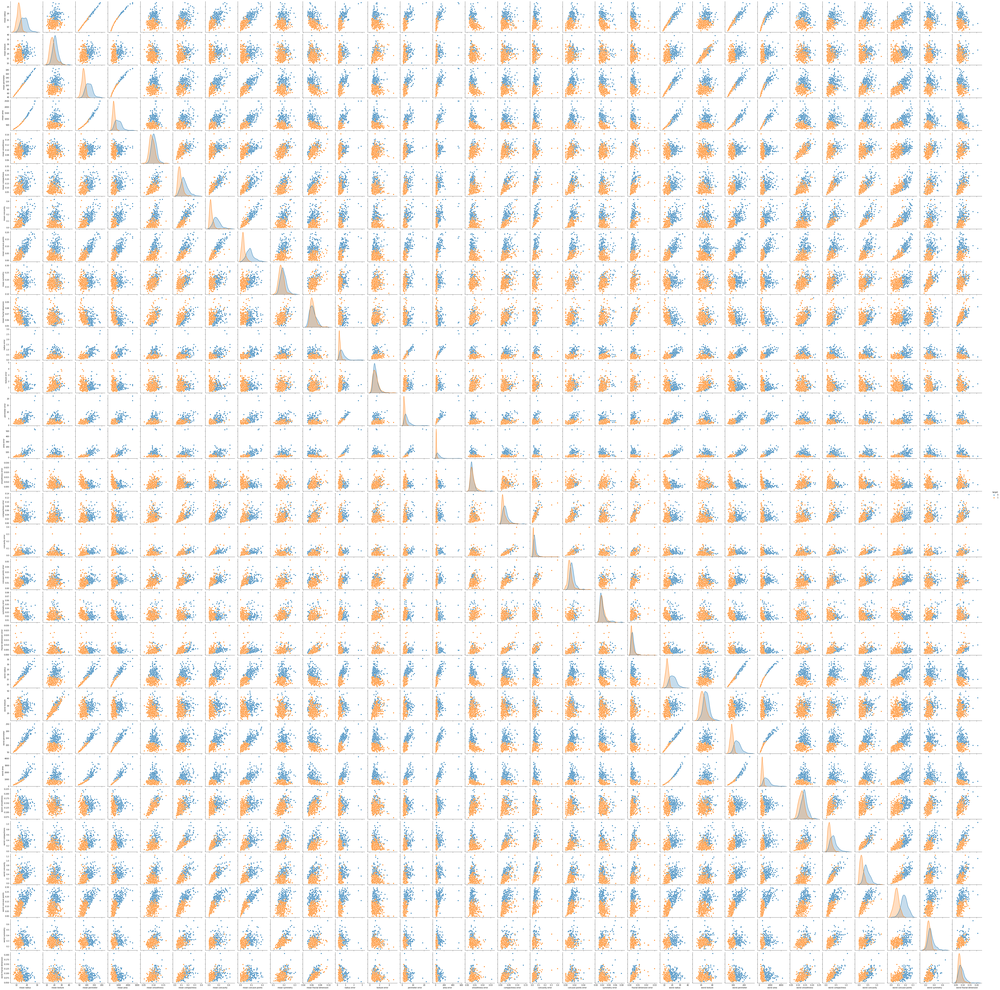

In [ ]:
sns.pairplot(cancer_df , hue = 'target')

In [ ]:
cancer_df.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'target'],
      dtype='object')

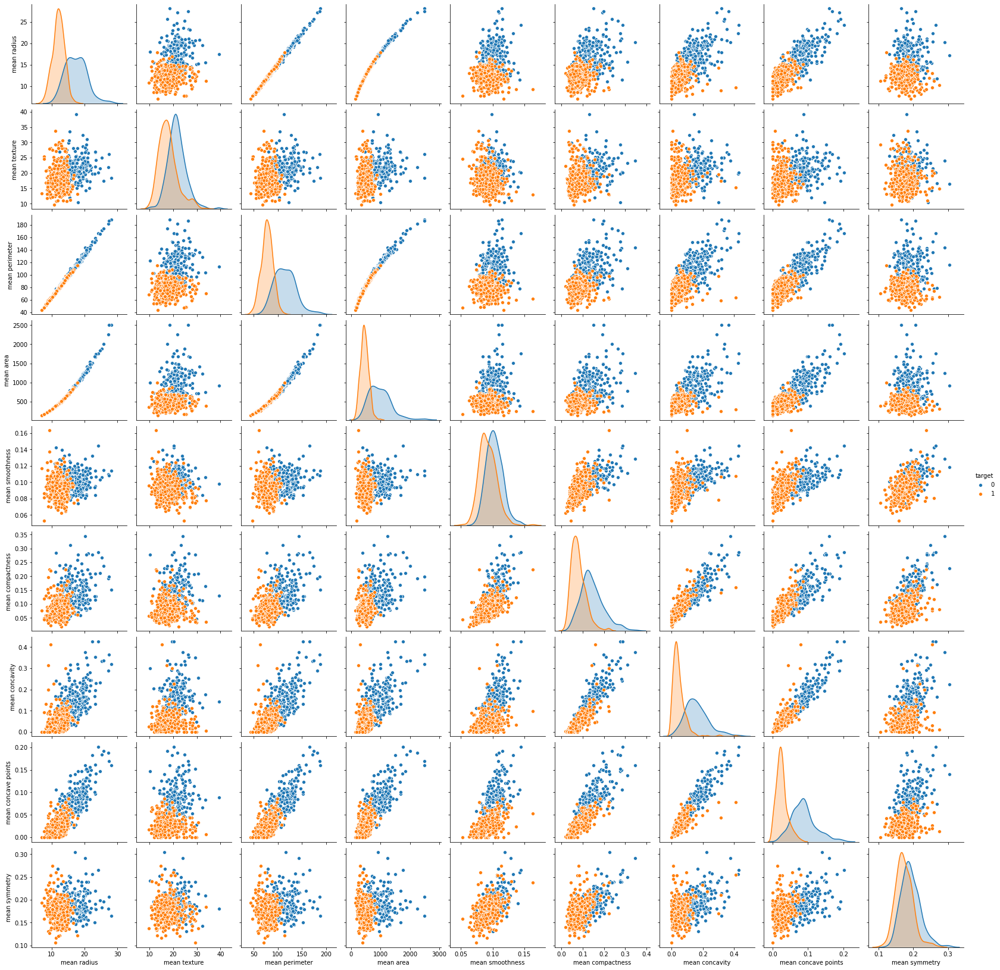

In [ ]:
sns.pairplot(cancer_df[['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry','target']],hue = 'target')

We can see patient who had a cancer has higer mean value as compare to the patient who are not suffering from the cancer

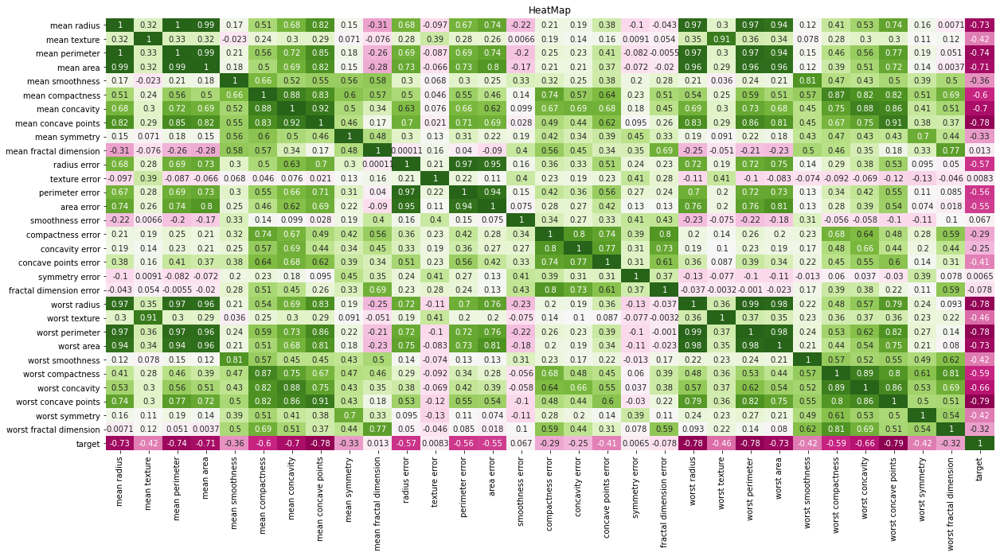

In [ ]:
fig,ax = plt.subplots(figsize=(20,10))
ax = sns.heatmap(cancer_df.corr(), annot=True, cbar=False,cmap = 'PiYG')
ax.set_title('HeatMap')
plt.show()

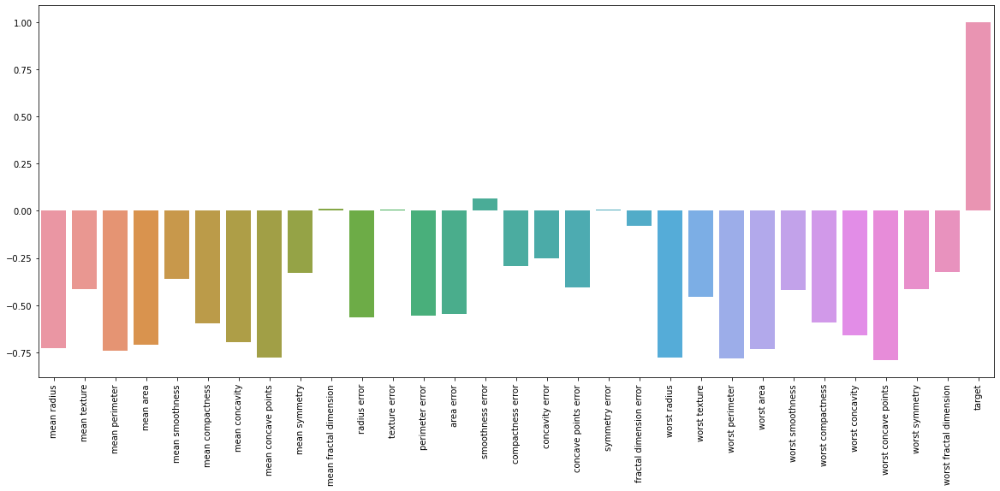

In [ ]:
fig , ax = plt.subplots(figsize = (20,8))
ax = sns.barplot(x = cancer_df.columns, y = cancer_df.corr()['target'].values)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

**There are some features like `mean concave points`,`texture error`,`smoothness error`,`synmentry error`, `fractal dimension error` having ver low corelation with target variables**

In [ ]:
for i,k in dict(cancer_df.corr()['target']).items():
  if abs(k) <= 0.1:
    cancer_df.drop(i,axis = 1, inplace=True)

here we have droped all the column where correlation is less then 10% absolute value

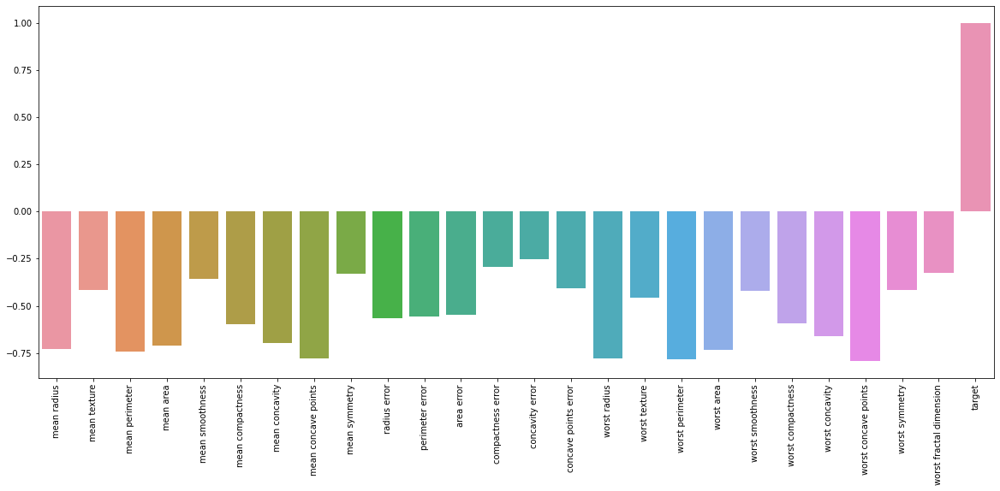

In [ ]:
fig , ax = plt.subplots(figsize = (20,8))
ax = sns.barplot(x = cancer_df.columns, y = cancer_df.corr()['target'].values)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
plt.show()

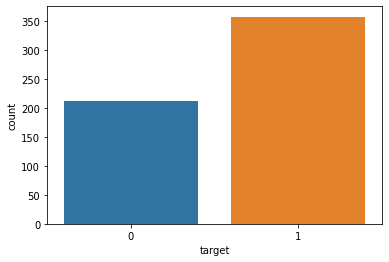

In [ ]:
sns.countplot(cancer_df['target']);

**Number of Diseased Patient is higher then the number of not diseased**

## Split the data into train and test

In [ ]:
X = cancer_df.drop('target', axis = 1)
y = cancer_df['target']

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 42)

## Feature Scaling

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_processed = scaler.fit_transform(X_train)
X_test_processed = scaler.fit_transform(X_test)

In [ ]:
X_train_processed

array([[-0.34913849, -1.43851335, -0.41172595, ..., -0.91671059,
        -0.92508585, -0.80841115],
       [-0.20468665,  0.31264011, -0.13367256, ...,  1.43655962,
         1.14955889,  1.56911143],
       [-0.32931176, -0.21507235, -0.31739376, ..., -0.7237126 ,
         0.53496977, -0.61934827],
       ...,
       [ 0.04739597, -0.56293662, -0.06529202, ..., -1.23262438,
        -0.68282718, -1.261137  ],
       [-0.04040808,  0.09966199, -0.03151368, ...,  1.08847951,
         0.48944465,  1.26159953],
       [-0.5502381 ,  0.31264011, -0.6040977 , ..., -0.59582424,
        -0.29911546, -0.82948141]])

## Building and fitting the model

Lets Built a function with all the possible model

* Function will recive X_train, y_train, X_test, y_test
* First it will intentiate all the model to the variables
* Fitting, training and predicting the model
* In last it will return, Evaluations, Predictions and model

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score,precision_score,recall_score,f1_score

In [ ]:
def predict_evaluate(X_train_processed,y_train, X_test_processed,y_test):
  lr = LogisticRegression(random_state = 51, penalty = 'l2')
  rf = RandomForestClassifier(n_estimators = 20, criterion = 'entropy', random_state = 51)
  Knn = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
  Nb = GaussianNB()
  Dt = DecisionTreeClassifier(criterion = 'entropy', random_state = 51)
  svm = SVC()
  adb_classifier = AdaBoostClassifier(DecisionTreeClassifier(criterion = 'entropy', random_state = 200),
                                    n_estimators=2000,
                                    learning_rate=0.1,
                                    algorithm='SAMME.R',
                                    random_state=1,)
  


  lr.fit(X_train_processed,y_train)
  rf.fit(X_train_processed,y_train)
  Knn.fit(X_train_processed,y_train)
  Nb.fit(X_train_processed,y_train)
  Dt.fit(X_train_processed,y_train)
  svm.fit(X_train_processed,y_train)
  adb_classifier.fit(X_train_processed,y_train)

  


  lr_pred = lr.predict(X_test_processed)
  rf_pred = rf.predict(X_test_processed)
  knn_pred = Knn.predict(X_test_processed)
  Nb_pred = Nb.predict(X_test_processed)
  Dt_pred = Dt.predict(X_test_processed)
  svm_pred = svm.predict(X_test_processed)
  adb_classifier_pred = adb_classifier.predict(X_test_processed)
  
  predict_dict = {
      'LogisticRegression' : lr_pred,
      'RandomForest' : rf_pred,
      'KNeighborsClassifier' : knn_pred,
      'Navie_baise' : Nb_pred,
      'Decission_Tree' : Dt_pred,
      'SVM' : svm_pred,
      'adb_classifier' : adb_classifier_pred
  }


  recall_dict = {
      'LogisticRegression' :round(recall_score(y_test,predict_dict['LogisticRegression'])*100,2),
      'RandomForest' :round(recall_score(y_test,predict_dict['RandomForest'])*100,2),
      'KNeighborsClassifier' :round(recall_score(y_test,predict_dict['KNeighborsClassifier'])*100,2),
      'Navie_baise' :round(recall_score(y_test,predict_dict['Navie_baise'])*100,2),
      'Decission_Tree' :round(recall_score(y_test,predict_dict['Decission_Tree'])*100,2),
      'SVM' :round(recall_score(y_test,predict_dict['SVM'])*100,2),
      'adb_classifier' :round(recall_score(y_test,predict_dict['adb_classifier'])*100,2)
  }

  precision_dict = {
      'LogisticRegression' :round(precision_score(y_test,predict_dict['LogisticRegression'])*100,2),
      'RandomForest' :round(precision_score(y_test,predict_dict['RandomForest'])*100,2),
      'KNeighborsClassifier' :round(precision_score(y_test,predict_dict['KNeighborsClassifier'])*100,2),
      'Navie_baise' :round(precision_score(y_test,predict_dict['Navie_baise'])*100,2),
      'Decission_Tree' :round(precision_score(y_test,predict_dict['Decission_Tree'])*100,2),
      'SVM' :round(precision_score(y_test,predict_dict['SVM'])*100,2),
      'adb_classifier' :round(precision_score(y_test,predict_dict['adb_classifier'])*100,2)
  }

  accuracy_dict = {
      'LogisticRegression' : round(accuracy_score(y_test,predict_dict['LogisticRegression'])*100,2),
      'RandomForest' : round(accuracy_score(y_test,predict_dict['RandomForest'])*100,2),
      'KNeighborsClassifier' : round(accuracy_score(y_test,predict_dict['KNeighborsClassifier'])*100,2),
      'Navie_baise' : round(accuracy_score(y_test,predict_dict['Navie_baise'])*100,2),
      'Decission_Tree' : round(accuracy_score(y_test,predict_dict['Decission_Tree'])*100,2),
      'SVM' : round(accuracy_score(y_test,predict_dict['SVM'])*100,2),
      'adb_classifier' : round(accuracy_score(y_test,predict_dict['adb_classifier'])*100,2)
  }

  f1_score_dict = {
      'LogisticRegression' :round(f1_score(y_test,predict_dict['LogisticRegression'])*100,2),
      'RandomForest' :round(f1_score(y_test,predict_dict['RandomForest'])*100,2),
      'KNeighborsClassifier' :round(f1_score(y_test,predict_dict['KNeighborsClassifier'])*100,2),
      'Navie_baise' :round(f1_score(y_test,predict_dict['Navie_baise'])*100,2),
      'Decission_Tree' :round(f1_score(y_test,predict_dict['Decission_Tree'])*100,2),
      'SVM' :round(f1_score(y_test,predict_dict['SVM'])*100,2),
      'adb_classifier' :round(f1_score(y_test,predict_dict['adb_classifier'])*100,2)
  }

  Evaluation_df = pd.DataFrame([precision_dict,recall_dict,f1_score_dict,accuracy_dict], index = ['Precision_Score','Recall_score','F1_score','Accuracy'])

  prediction_df = pd.concat([pd.DataFrame(predict_dict,index = y_test.index),pd.DataFrame(y_test)], axis = 1)
  
  Evaluation_df['MaxValue'] = [np.max(Evaluation_df.loc[i].values) for i in Evaluation_df.index]
  Evaluation_df['Best_performing_Model'] = [Evaluation_df.columns[np.argmax(np.max(Evaluation_df.loc[i].values))] for i in Evaluation_df.index]

  models = {'Logistic_Regression' : lr,
            'Random_Forest_Classfier' : rf,
            'Knn_Classifier' : Knn,
            'Navie_Bayes' : Nb,
            'Decision_Tree' : Dt,
            'Support_Vector_Machine' : svm,
            'ADB_Classifier' : adb_classifier }

  
  
  return Evaluation_df,prediction_df, models


In [ ]:
evaluation, prediction,models = predict_evaluate(X_train_processed,y_train, X_test_processed,y_test)

## Prediction

In [ ]:
prediction.head()

,LogisticRegression,RandomForest,KNeighborsClassifier,Navie_baise,Decission_Tree,SVM,adb_classifier,target
204,1,1,1,1,1,1,1,1
70,0,0,0,0,0,0,0,0
131,0,0,0,0,0,0,0,0
431,1,1,1,1,1,1,1,1
540,1,1,1,1,1,1,1,1


In [ ]:
import plotly.express as px
import cufflinks as cf
import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
cf.set_config_file(theme = 'pearl',
                  sharing = 'public',
                  offline = True)

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

fig = go.Figure(data=go.Heatmap(
                    z= prediction.values,
                    x = prediction.columns
                    ))
fig.show()

the above heat map seems to be confusing but this giving us very important aspect. 

Dark colour represent the 0. And light represent the 1. So if dark colour line goes strait that means every model has made a  correct prediction for patient do not diseased, same for light color. 

Like in index 165 every model predicted correct value except `Decision Tree` and `adb_classifier`

## Evaluation Matrix

In [ ]:
evaluation

,LogisticRegression,RandomForest,KNeighborsClassifier,Navie_baise,Decission_Tree,SVM,adb_classifier,MaxValue,Best_performing_Model
Precision_Score,97.80,96.70,97.78,94.57,94.68,96.70,94.68,97.80,LogisticRegression
Recall_score,100.00,98.88,98.88,97.75,100.00,98.88,100.00,100.00,LogisticRegression
F1_score,98.89,97.78,98.32,96.13,97.27,97.78,97.27,98.89,LogisticRegression
Accuracy,98.60,97.20,97.90,95.10,96.50,97.20,96.50,98.60,LogisticRegression


**Precision_Score** : Total_Correct_Positive_Prediction/Total_Positive_Prediction

**Recall_Score** : Total_Correct_Positive_Prediction/Total_Positive_True_Label

Here if we see the best performing model is Logistic regression in all the aspect

In [ ]:
evaluation.iloc[:,:7]

,LogisticRegression,RandomForest,KNeighborsClassifier,Navie_baise,Decission_Tree,SVM,adb_classifier
Precision_Score,97.80,96.70,97.78,94.57,94.68,96.70,94.68
Recall_score,100.00,98.88,98.88,97.75,100.00,98.88,100.00
F1_score,98.89,97.78,98.32,96.13,97.27,97.78,97.27
Accuracy,98.60,97.20,97.90,95.10,96.50,97.20,96.50


## Confusion_Matrix

In [ ]:
for i in evaluation.iloc[:,:7].columns:
  print('-----------********--------------------')
  print("")
  print(i)
  display(pd.DataFrame(confusion_matrix(y_test, prediction[i]),columns=['Actual_doesn\'t_diseased','Actual_has_diseased'],
               index = ['predict_doesn\'t_diseased','predict_has_diseased']))
  display(evaluation[i])

-----------********--------------------

LogisticRegression


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,52,2
predict_has_diseased,0,89


Precision_Score     97.80
Recall_score       100.00
F1_score            98.89
Accuracy            98.60
Name: LogisticRegression, dtype: float64

-----------********--------------------

RandomForest


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,51,3
predict_has_diseased,1,88


Precision_Score    96.70
Recall_score       98.88
F1_score           97.78
Accuracy           97.20
Name: RandomForest, dtype: float64

-----------********--------------------

KNeighborsClassifier


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,52,2
predict_has_diseased,1,88


Precision_Score    97.78
Recall_score       98.88
F1_score           98.32
Accuracy           97.90
Name: KNeighborsClassifier, dtype: float64

-----------********--------------------

Navie_baise


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,49,5
predict_has_diseased,2,87


Precision_Score    94.57
Recall_score       97.75
F1_score           96.13
Accuracy           95.10
Name: Navie_baise, dtype: float64

-----------********--------------------

Decission_Tree


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,49,5
predict_has_diseased,0,89


Precision_Score     94.68
Recall_score       100.00
F1_score            97.27
Accuracy            96.50
Name: Decission_Tree, dtype: float64

-----------********--------------------

SVM


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,51,3
predict_has_diseased,1,88


Precision_Score    96.70
Recall_score       98.88
F1_score           97.78
Accuracy           97.20
Name: SVM, dtype: float64

-----------********--------------------

adb_classifier


,Actual_doesn't_diseased,Actual_has_diseased
predict_doesn't_diseased,49,5
predict_has_diseased,0,89


Precision_Score     94.68
Recall_score       100.00
F1_score            97.27
Accuracy            96.50
Name: adb_classifier, dtype: float64

## Final Visualization

In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
data = [go.Bar(x = evaluation.iloc[:,:8].index, y = evaluation.iloc[:,:8][i], name=i, text = evaluation.iloc[:,:8][i], 
               textposition='auto') for i in evaluation.iloc[:,:8].columns]
fig = go.Figure(
    data=data,
    layout=dict(title=dict(text="Different Evaluation Score"))
)
fig.show()

## Feature Importace

Feature importance is another way to evaluate which feature contributes most to the model. This will also going to show the correlation but here we will going to see the correlation based on the model prediction. 

In [ ]:
lr = models['LogisticRegression']

In [ ]:
display(len(X_test.columns)) 

feature_df = pd.DataFrame(dict(zip(X_test.columns,list(np.round(lr.coef_[0],2)))),index = [0]).T
feature_df.columns = ['Coffeciet']
feature_df

25

,Coffeciet
mean radius,-0.46
mean texture,-0.43
mean perimeter,-0.41
mean area,-0.50
mean smoothness,-0.16
mean compactness,0.76
mean concavity,-0.61
mean concave points,-1.04
mean symmetry,0.36
radius error,-1.21


In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
data = [go.Bar(y = feature_df['Coffeciet'], x = feature_df.index, text=feature_df['Coffeciet'], textposition='auto')]
layout = go.Layout({
    'title' : 'Cofficient_Of_Feature_Variable'
})
fig = go.Figure(data,layout)

fig.show()

All this is showing the pattern which model is able to detect from the data. And it turn out to be `radius error , worst texture and worst concavity` are one of the most important feature in deciding wheather a patient have a heart disease or not.

Negative shows the inverse relationship as the value of these feature decrease chances of have heart disease increases.



##Saving and loading the modle

In [ ]:
import pickle

pickle.dump(models[0],open('brest_cancer_detection.pickle','wb'))

# load model
breast_cancer_detector_model = pickle.load(open('brest_cancer_detection.pickle', 'rb'))
 
# predict the output
y_pred = breast_cancer_detector_model.predict(X_test_processed)
 
# confusion matrix
print('Confusion matrix of Logistic Regression Model: \n',confusion_matrix(y_test, y_pred),'\n')
 
# show the accuracy
print('Accuracy of Logistic Regression = ',accuracy_score(y_test, y_pred))

Confusion matrix of Logistic Regression Model: 
 [[52  2]
 [ 0 89]] 

Accuracy of Logistic Regression =  0.986013986013986


## Final Conclusion

* Logistic Regression seems to be the best fit algorith for our problem
* We are able to get the `98.6` accuracy
* Recall_Score is higher then the precision score. Which means predicting patient get diseased is far more easy rather then predicting patient doesn't get diseased.
* Size of our data is very less if we get more data then we might get more appropreate result


**Now it's time for the deployment of our model in to the web using flask**
